# EuMetSat data exploration

Notebook for having fun with EuMetSat cloud mask data.

## Environment setup

Lets load all needed stuff

In [1]:
import numpy as np
import netCDF4
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy
import seaborn as sns

# This will make xarray output nice in jupyter
xr.set_options(display_style="html")

## Loading sample data file

Here we are loading sample netcdf file with single cloud mask from EuMetSet. We are using low level netcdf4 library. It is very easy and stright forward:

In [2]:
url = 'EuMetSatData/W_XX-EUMETSAT-Darmstadt,SING+LEV+SAT,MSG2+CLM_C_EUMG_20200117120000.nc'
nc = netCDF4.Dataset(url)
# Here we have loaded obect
print(nc)
print('-------------')
# But most important data are here so data tables
print(nc.variables)
print('-------------')
# Data size
print(nc.dimensions)


<class 'netCDF4._netCDF4.Dataset'>
root group (NETCDF3_CLASSIC data model, file format NETCDF3):
    creator_name: EUMETSAT
    creator_url: http://archive.eumetsat.int
    creator_email: archive@eumetsat.int
    institution: EUMETSAT
    license: CopyRight EUMETSAT 2008
    Conventions: CF-1.0
    Metadata_Conventions: Unidata Dataset Discovery v1.0
    title: EUMETSAT-ARCHIVE-CLOUD-MASK-NetCDF
    summary: NA
    keywords: EUMETSAT, ARCHIVE, NetCDF, CLOUD MASK
    history: EUMETSAT CopyRight 2008
    comment: DRAFT VERSION
    wmo_filename: W_XX-EUMETSAT-Darmstadt,SING+LEV+SAT,MSG2+CLM_C_EUMG_20200117120000.nc
    GRIB_param_Nx: 3712
    GRIB_param_Ny: 3712
    GRIB_orgReferenceTime: 20200117120000
    latitude_of_projection_origin: 0.0
    longitude_of_projection_origin: 0.0
    time_coverage_start: 20200117120000
    time_coverage_end: 20200117120000
    source: /data/products/1380228/MSG2-SEVI-MSGCLMK-0100-0100-20200117120000.000000000Z-20200117121419-1380228.nc.tmp
    dimensions

Ok so lets try to visualize what we have with matplot lib. We will lower resolution just for fast rendering.

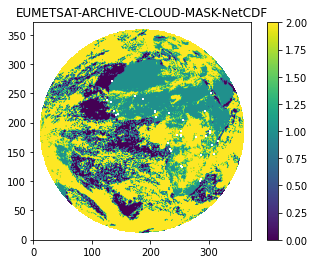

In [3]:
plt.imshow(nc.variables['cloudMask'][::10,::10], origin='lower')
plt.title(nc.title)
plt.colorbar()

Nice! We have see picture of earth done from geostationary orbit. Be aware that cloud mask is final produkt of various postprocessing and is not real image.

Please take look on values visible on plot and values which was described in flag_values_names and flag_values. 



In [4]:
print (nc.variables['cloudMask'].flag_values_names)
print (nc.variables['cloudMask'].flag_values)

clear_sky_over_water, clear_sky_over_land, cloud, no_data (space)
0b, 1b, 2b, 3b


We can see now how cloud mask data looks like and how are repesented. Also it is good to known that netcdf library use numpy mask matrix to holds data. We have to matrix one with raw data and second with mask which represent if this cell has value or don't have any. In raw data corners of matrix will have value 3 so space (no_data) but during any calculation (i.e. some statistical function like mean) because of mask existence they will be not taken into account. Value 3 do not exist in data so we don't have it on plot legen bar for example. Below you can see how cloud mask is presented as masked matrix then raw data and last is mask values. We see four corners of picture so all of this data are masked.



In [5]:
print (nc.variables['cloudMask'][:,:])
print (nc.variables['cloudMask'][:,:].data)
print (nc.variables['cloudMask'][:,:].mask)

[[-- -- -- ... -- -- --]
 [-- -- -- ... -- -- --]
 [-- -- -- ... -- -- --]
 ...
 [-- -- -- ... -- -- --]
 [-- -- -- ... -- -- --]
 [-- -- -- ... -- -- --]]
[[3. 3. 3. ... 3. 3. 3.]
 [3. 3. 3. ... 3. 3. 3.]
 [3. 3. 3. ... 3. 3. 3.]
 ...
 [3. 3. 3. ... 3. 3. 3.]
 [3. 3. 3. ... 3. 3. 3.]
 [3. 3. 3. ... 3. 3. 3.]]
[[ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]
 ...
 [ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]]


netcdf library is low level library. In most cases we just want xarray to load all data at once but sadly when we try to achive that we will get here:

In [6]:
invalid_data_set = xr.open_dataset(url)

MissingDimensionsError: 'lat' has more than 1-dimension and the same name as one of its dimensions ('lat', 'lon'). xarray disallows such variables because they conflict with the coordinates used to label dimensions.

This is very well known error and there is no solution for that in xarray (please see https://github.com/pydata/xarray/issues/2368). When we look on data we will see that this is image of globe from geostationary orbit. We have image pixel coordinate system x and y. For every pixel (x,y) we have cloud mask value, longitude and latitude coordinates. We want to have cloud mask value from pair of geo coordinates so (lon, lat) but both of them are not simple axis but matrixes which depends on (x,y). You see that we use longitude and latitude in some contects as axis of coordinate system but in other as value that should be extracted from x and y coordinate system. xarray was develop on some assumptions and one of them is that axis is axis not data and axis in the same time. 

To be clear this netcdf file is valid and limitation is inside xarray implementation so that is why netcdf4 is loading this data without problem. 

## xarray workaround

Workaround is simple. We are loading data by netcdf4 library and then create xarray dataset from hand.

In [7]:
# Extract all data matrix from netcdf file
cloud_mask_data = nc.variables["cloudMask"][:,:]
lat_data = nc.variables["lat"][:,:]
lon_data = nc.variables["lon"][:,:]

# Create dummy coordinates vectors
shape = nc.variables["cloudMask"].shape
x_data = range(0, shape[0])
y_data = range(0, shape[1])

# Create xarray data arrais
cloud_mask_xar = xr.DataArray(cloud_mask_data, coords={'x': x_data, 'y': y_data}, dims=['x', 'y'])
lat_xar = xr.DataArray(lat_data, coords={'x': x_data, 'y': y_data}, dims=['x', 'y'])
lon_xar = xr.DataArray(lon_data, coords={'x': x_data, 'y': y_data}, dims=['x', 'y'])

# Combine data into xarray Dataset
data_set_xr = xr.Dataset({'cloudMask': cloud_mask_xar},
                          coords={'lat': lat_xar, 'lon': lon_xar})
data_set_xr

<xarray.Dataset>
Dimensions:    (x: 3712, y: 3712)
Coordinates:
  * x          (x) int64 0 1 2 3 4 5 6 7 ... 3705 3706 3707 3708 3709 3710 3711
  * y          (y) int64 0 1 2 3 4 5 6 7 ... 3705 3706 3707 3708 3709 3710 3711
    lat        (x, y) float32 nan nan nan nan nan nan ... nan nan nan nan nan
    lon        (x, y) float32 nan nan nan nan nan nan ... nan nan nan nan nan
Data variables:
    cloudMask  (x, y) float32 nan nan nan nan nan nan ... nan nan nan nan nan

What is here important is that we have multidimensional coordinate system:

- we have one data variables which is cloud mas 
- we have 4 different coordinate axis
  - x and y are logical coordinate system - how data are stored 
  - lat and lon are physical coordinate system - what physical position this data represent

We just add some kind of abstraction layer between coordination systems.

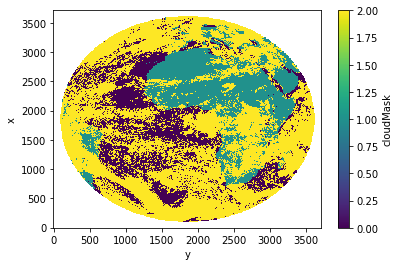

In [8]:
data_set_xr.cloudMask[::10, ::10].plot()

Ok so we have similar result like with netcdf and matplotlib but take closer look on axis values. Using matplotlib with netcdf data and lowering resolution we get invalid axis values. Using xarray we get correct axis values. We can now make even better plots using cartopy package:

In [9]:
# dataset_test.cloudMask.plot()
plt.figure(figsize=(14,6))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_global()
ax.set_ylim([-70,70]) 
ax.set_xlim([-90,90])
ax.coastlines()
data_set_xr.cloudMask.plot.contourf(ax=ax, transform=ccrs.PlateCarree(), x='lon', y='lat', add_colorbar=False)
